# Descriptors

## 1st Try (PROBLEM)

In [1]:
class IntegerValue:
    '''
    DESCRIPTOR
    '''
    def __init__(self, value=None):
        print('__init__ IntegerValue Instance')
        if value:
            self.set(value)  
    def get(self):
        print('calling get')
        return self._value
    def set(self, value):
        print('calling set')
        self._value = int(value)
    

class Point2D:
    x = IntegerValue()
    y = IntegerValue()
    

__init__ IntegerValue Instance
__init__ IntegerValue Instance


In [2]:
p = Point2D()

In [3]:
p.x = 10

In [4]:
p.__dict__

{'x': 10}

In [5]:
type(p.x)  # it shadowed class attribute!!

int

In [6]:
p2 = Point2D()
p2.x

In [7]:
type(p2.x)

__main__.IntegerValue

In [9]:
p2.x.set(10)
p2.x.get()

calling set
calling get


10

In [11]:
p2.y.set(20)
p2.y.get()

calling set
calling get


20

In [13]:
p3 = Point2D()

In [14]:
p3.x.get()  # PROBLEM: IntegerValue instances are BOUND to class NOT instace...

calling get


10

In [15]:
p3.x.set(111)
p3.x.get()

calling set
calling get


111

In [16]:
p2.x.get()  # It is no longer 10! They are sharing this class attribute!!!

calling get


111

## 2nd try (PROBLEM)

In [18]:
class IntegerValue:
    '''
    DESCRIPTOR
    '''
    def __init__(self, value=None):
        print('__init__ IntegerValue Instance')
        if value:
            self.set(value)  
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if not instance:
            return self
        return self._value
    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')
        self._value = int(value)
    

class Point2D:
    x = IntegerValue()
    y = IntegerValue()

__init__ IntegerValue Instance
__init__ IntegerValue Instance


In [20]:
p = Point2D()
p.x = 10

calling set
self=<__main__.IntegerValue object at 0x0000026994FBA508>, instance=<__main__.Point2D object at 0x0000026994F89FC8>


In [21]:
p.x

calling get
self=<__main__.IntegerValue object at 0x0000026994FBA508>, instance=<__main__.Point2D object at 0x0000026994F89FC8>, owner_class=<class '__main__.Point2D'>


10

In [22]:
p2 = Point2D()
p2.x   # PROBLEM: attribute x is shared by all instances!!!

calling get
self=<__main__.IntegerValue object at 0x0000026994FBA508>, instance=<__main__.Point2D object at 0x0000026994578B08>, owner_class=<class '__main__.Point2D'>


10

In [23]:
p2.x = 22
p2.x

calling set
self=<__main__.IntegerValue object at 0x0000026994FBA508>, instance=<__main__.Point2D object at 0x0000026994578B08>
calling get
self=<__main__.IntegerValue object at 0x0000026994FBA508>, instance=<__main__.Point2D object at 0x0000026994578B08>, owner_class=<class '__main__.Point2D'>


22

In [24]:
p.x  

calling get
self=<__main__.IntegerValue object at 0x0000026994FBA508>, instance=<__main__.Point2D object at 0x0000026994F89FC8>, owner_class=<class '__main__.Point2D'>


22

## 3rd try (progress but still PROBLEM)

#### Storing it as instance attribute. 

- It solves the problem that is no longer shared with other class attributes

#### Problems:
- Doens't work with multiple descriptor instances!
- It may override instance attribute
- doesn't work with slots (cannot add 'stored_value' in instance dict unless we specify that in slots in Point2D)

In [29]:
class IntegerValue:
    '''
    DESCRIPTOR
    '''
            
    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        instance.stored_value = int(value)
        
        # previous
        #self._value = int(value) 
            
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        return getattr(instance, 'stored_value', None)
        
        # previous
        #return self._value
    
    

class Point2D:
    x = IntegerValue()
    y = IntegerValue()

In [30]:
p = Point2D()
p.x = 11

calling set
self=<__main__.IntegerValue object at 0x0000026994FC1908>, instance=<__main__.Point2D object at 0x0000026994FC4C48>


In [31]:
p.x

calling get
self=<__main__.IntegerValue object at 0x0000026994FC1908>, instance=<__main__.Point2D object at 0x0000026994FC4C48>, owner_class=<class '__main__.Point2D'>


11

In [32]:
p.__dict__

{'stored_value': 11}

In [34]:
p2 = Point2D()
p2.x = 22

calling set
self=<__main__.IntegerValue object at 0x0000026994FC1908>, instance=<__main__.Point2D object at 0x0000026994FBD988>


In [35]:
p2.x

calling get
self=<__main__.IntegerValue object at 0x0000026994FC1908>, instance=<__main__.Point2D object at 0x0000026994FBD988>, owner_class=<class '__main__.Point2D'>


22

In [36]:
p2.__dict__

{'stored_value': 22}

In [38]:
p.__dict__

{'stored_value': 11}

#### It seems like it worked, but the problem is that if we create 2 instances of descriptor:
x = IntegerValue() <br>
y = IntegerValue() <br>
then code will break:

In [39]:
p.y = 33

calling set
self=<__main__.IntegerValue object at 0x0000026994FC1988>, instance=<__main__.Point2D object at 0x0000026994FC4C48>


In [40]:
p.y

calling get
self=<__main__.IntegerValue object at 0x0000026994FC1988>, instance=<__main__.Point2D object at 0x0000026994FC4C48>, owner_class=<class '__main__.Point2D'>


33

#### PROBLEM is that attribute 'stored_value' is shared between different descriptor instances!

In [41]:
p.__dict__  

{'stored_value': 33}

## 4th try (small PROBLEM)

### Give a name to each instance descriptor at creation, and make instance aware of this

#### Problems:
- we have to give as input the names that we want for attributes. Like 'x' or 'y'
- We assume '_x' and '_y' is not used already by the user in the class
- doesn't work with slots. If Point2D implemented slots, then we couldn't just add '_x' and '_y' in the instance dictionary, unless we specify that in the slots

In [1]:
class IntegerValue:
    '''
    DESCRIPTOR
    ''' 
    def __init__(self, name):  # We are giving each attribute a separate name!
        self.storage_name = '_' + name
            
    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        # we cannot say instance.self.stored_value = int(value). 
        # Use setattr:
        
        setattr(instance, self.storage_name, int(value))
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        #previous
        #return getattr(instance, 'stored_value', None)
        
        return getattr(instance, self.storage_name, None)
    
    

class Point2D:
    x = IntegerValue('x')  # notice the input 'x' now that contributes to naming 
    y = IntegerValue('y')

In [4]:
p = Point2D()
p.x = 10
p.y = 11

calling set
self=<__main__.IntegerValue object at 0x000001EC9BE09548>, instance=<__main__.Point2D object at 0x000001EC9BE26388>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BE09648>, instance=<__main__.Point2D object at 0x000001EC9BE26388>


In [5]:
p.__dict__

{'_x': 10, '_y': 11}

In [7]:
p2 = Point2D()
p2.x = 22
p2.y = 23

calling set
self=<__main__.IntegerValue object at 0x000001EC9BE09548>, instance=<__main__.Point2D object at 0x000001EC9BEA20C8>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BE09648>, instance=<__main__.Point2D object at 0x000001EC9BEA20C8>


In [8]:
p2.__dict__

{'_x': 22, '_y': 23}

In [10]:
p.__dict__

{'_x': 10, '_y': 11}

#### the problem is the following:

In [11]:
p3 = Point2D()
p3._x = 777

In [12]:
# Overriden!

p3.x = 121212
p3.__dict__

calling set
self=<__main__.IntegerValue object at 0x000001EC9BE09548>, instance=<__main__.Point2D object at 0x000001EC9BEA5BC8>


{'_x': 121212}

## 5th try (kinda WORKS but assumes hashable instances of Point2D)

#### Instead of trying to store something on the instance (which if it is slotted they we cannot store) we can create storage inside the descriptor which can be instance specific

- fixes slot issue pon the instance, but still assumes class is hashable. If you define dunder eq you need to define dunder hash also!
- memory leaks!!

In [29]:
class IntegerValue:
    '''
    DESCRIPTOR
    ''' 
    def __init__(self):  # We are giving each attribute a separate name!
        #self.storage_name = '_' + name
        self.values = {}
        # we don't have to worry about the name of the property
        # since x and y are different descriptors, will have different values {} dict
            
    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        #setattr(instance, self.storage_name, int(value))
        
        # Create instance specific storage! Different instance of Point2D will have different storage
        self.values[instance] = int(value)    #here we assume instance is hashable!
    
        
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        #previous
        #return getattr(instance, self.storage_name, None)
        
        return self.values.get(instance)  # It returns None if we do get before set
        # self.values
    
    

class Point2D:
    #x = IntegerValue('x') 
    #y = IntegerValue('y')
    
    x = IntegerValue() 
    y = IntegerValue()

In [16]:
p = Point2D()
p2 = Point2D()

In [22]:
p.x = 10
p.y = 11

calling set
self=<__main__.IntegerValue object at 0x000001EC9BEAE208>, instance=<__main__.Point2D object at 0x000001EC9BEAED48>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BEAE2C8>, instance=<__main__.Point2D object at 0x000001EC9BEAED48>


In [23]:
p2.x = 22
p2.y = 23

calling set
self=<__main__.IntegerValue object at 0x000001EC9BEAE208>, instance=<__main__.Point2D object at 0x000001EC9BEAED08>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BEAE2C8>, instance=<__main__.Point2D object at 0x000001EC9BEAED08>


In [24]:
p.x, p.y

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE208>, instance=<__main__.Point2D object at 0x000001EC9BEAED48>, owner_class=<class '__main__.Point2D'>
calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE2C8>, instance=<__main__.Point2D object at 0x000001EC9BEAED48>, owner_class=<class '__main__.Point2D'>


(10, 11)

In [25]:
p2.x, p2.y

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE208>, instance=<__main__.Point2D object at 0x000001EC9BEAED08>, owner_class=<class '__main__.Point2D'>
calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE2C8>, instance=<__main__.Point2D object at 0x000001EC9BEAED08>, owner_class=<class '__main__.Point2D'>


(22, 23)

#### take a look at the dictionary

In [26]:
Point2D.x  #returns the descriptor!

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE208>, instance=None, owner_class=<class '__main__.Point2D'>


In [27]:
Point2D.x.values

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE208>, instance=None, owner_class=<class '__main__.Point2D'>


{<__main__.Point2D at 0x1ec9beaed48>: 10,
 <__main__.Point2D at 0x1ec9beaed08>: 22}

In [28]:
Point2D.y.values

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEAE2C8>, instance=None, owner_class=<class '__main__.Point2D'>


{<__main__.Point2D at 0x1ec9beaed48>: 11,
 <__main__.Point2D at 0x1ec9beaed08>: 23}

#### Problem we have more than 1 references to the objects that p1 and p2 point to (because we use them as keys in the descriptor) Hence if we delete p1 and p2 the underlying object will still be there!!!

## 6th try Using WEAK references!
### Instead of storing the object as a key, store a weak reference to the object in the dictionary keys. Create a dictionary of weak reference (for our keys) for our data descriptor
 - weakred does NOT count in the reference count. 
 - When strong reference count (from ctypes) goes to zero then the object is destroyed
 - NO memory leaks
 - NO need to store data in the instances themsleves which may be sloted (solving slots problem)

### Problems:
- objects stored as keys in the dictinary should be HASHABLE!!  
- many build in types do NOT support weakref (int, string, list, dictionaries)

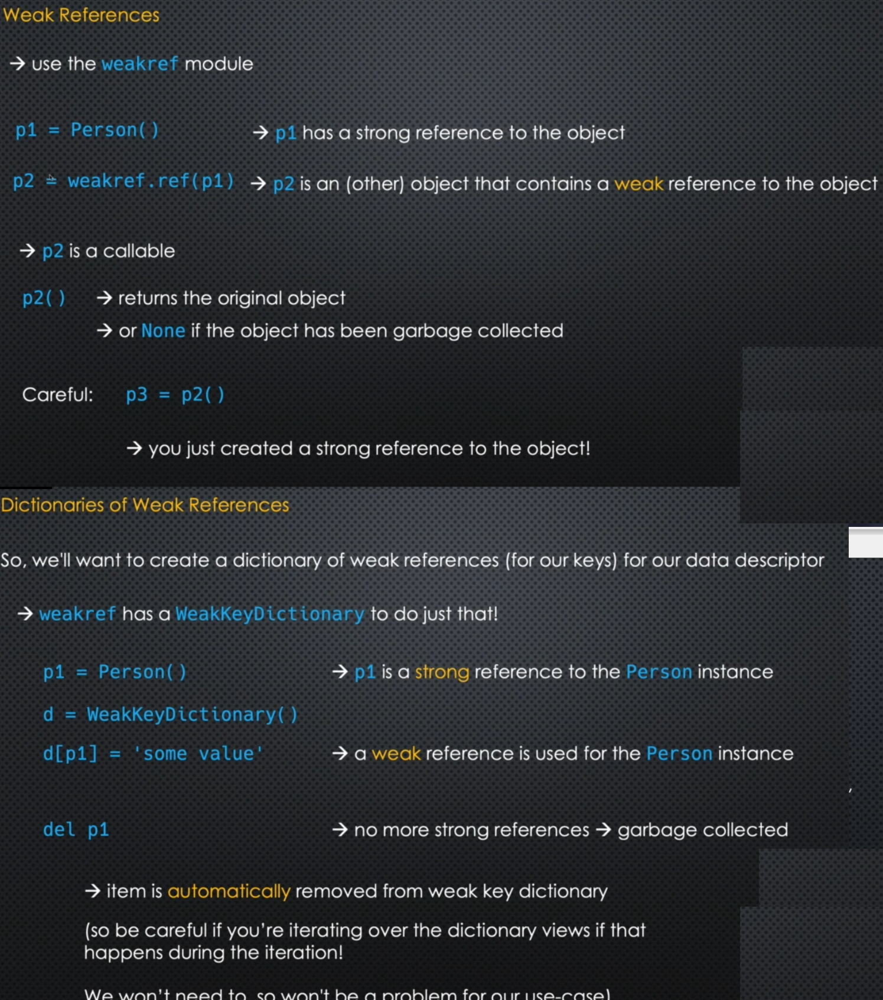

In [89]:
import weakref

class IntegerValue:
    '''
    DESCRIPTOR
    ''' 
    def __init__(self):  # We are giving each attribute a separate name!
        #self.storage_name = '_' + name
        #self.values = {}
        self.values = weakref.WeakKeyDictionary()  # keys are weak references to objects now!!!
            
    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        #setattr(instance, self.storage_name, int(value))
        
        self.values[instance] = int(value)    #here we assume instance is hashable!
        # get a weakref to instance
        # this assumes that the instnace is hashable and that you can have a weakref to it!
        
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        #previous
        #return getattr(instance, self.storage_name, None)
        
        return self.values.get(instance)  # It returns None if we do get before set
        # self.values
    
    

class Point2D:
    #x = IntegerValue('x') 
    #y = IntegerValue('y')
    
    x = IntegerValue() 
    y = IntegerValue()

In [97]:
p = Point2D()
p.x=10

calling set
self=<__main__.IntegerValue object at 0x000001EC9BEC5A48>, instance=<__main__.Point2D object at 0x000001EC9BECD608>


In [98]:
Point2D.x.values.keyrefs()

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEC5A48>, instance=None, owner_class=<class '__main__.Point2D'>


[<weakref at 0x000001EC9BEE7CC8; to 'Point2D' at 0x000001EC9BECD608>]

In [99]:
del p

In [100]:
Point2D.x.values.keyrefs()

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEC5A48>, instance=None, owner_class=<class '__main__.Point2D'>


[]

## WEAK REFERENCES

In [31]:
import weakref
import ctypes

def ref_count(address : int):
    return ctypes.c_long.from_address(address).value

In [58]:
class Person:
    pass

p1 = Person()

In [59]:
d1 = weakref.WeakKeyDictionary()
d2 = weakref.WeakKeyDictionary()

In [60]:
d1[p1] = 'Theo'
ref_count(id(p1)) , weakref.getweakrefcount(p1)

(1, 1)

In [61]:
d2[p1] = 'Rallou'
ref_count(id(p1)) , weakref.getweakrefcount(p1)

(1, 2)

In [62]:
p1.__weakref__  # double-linked list!

<weakref at 0x000001EC9BEC1318; to 'Person' at 0x000001EC9BEBF108>

In [63]:
d1.keyrefs()

[<weakref at 0x000001EC9BE227C8; to 'Person' at 0x000001EC9BEBF108>]

In [64]:
d2.keyrefs()

[<weakref at 0x000001EC9BEC1318; to 'Person' at 0x000001EC9BEBF108>]

In [65]:
hash(p1)  #HASHABLE OBJECT

-9223371904621035760

In [66]:
del p1

In [67]:
d1.keyrefs()

[]

## HASHABLE

#### It cannot go into the dictionary if it is unhashable!!!

In [83]:
class Person:
    def __init__(self, name):
        self.name = name
        
    def __eq__(self, other):
        return isinstance(other, Person) and self.name == other.name
    
    
p  = Person('Theo')
hash(p)

TypeError: unhashable type: 'Person'

In [84]:
d1[p] = 'stored'

TypeError: unhashable type: 'Person'

In [85]:
class Person:
    def __init__(self, name):
        self.name = name
        
    def __eq__(self, other):
        return isinstance(other, Person) and self.name == other.name
    
    def __hash__(self):  # Usually what we are using for comparison, use for the hash
        # make a tuple if necessary
        return hash(self.name)
    
p  = Person('Theo')
hash(p)

4274029789204457732

### Now that is hashable you can use it as keys to the dictionary!!!

In [86]:
p2 = Person('Georgia')

In [87]:
d1[p] = 'stored1'
d1[p2] = 'stored2'
d1.keyrefs()

[<weakref at 0x000001EC9BEE2138; to 'Person' at 0x000001EC9BEA2988>,
 <weakref at 0x000001EC9BEE2228; to 'Person' at 0x000001EC9BEA2A08>]

## WeakKeyDictionaries in data descriptors work only with hashable objects!!! 

## Moreover the keys that you store should be able to have a weakref (e.g. custom objects, but not primitive types!)

In [88]:
d1

# 7th try 

### The previous approach had the drawback that the objects should be hashable in order to be used as keys in the WeakKeyDictionary!! Moreover some primitive objects do not support weakrefs!

### In this approach we use id(instance) as a key (always hashable!)

### Pros:
- works for non HASHABLE objects since we store the ID and not the instance itself
- still not storing strong ref to dictionary as in 6th

### Problems:
- if the object is finalized and garbage collected, the corresponding entry still remains in the dictionary. The data dictioanry may contain id of instances that no longer exist and there is also a chance that the id itself is re-used. That was the big advantage on WeakKeyDictionary!!!


In [103]:
import weakref

class IntegerValue:
    '''
    DESCRIPTOR
    ''' 
    def __init__(self):  # We are giving each attribute a separate name!
        #self.storage_name = '_' + name
        self.values = {}

    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        #setattr(instance, self.storage_name, int(value))
        
        self.values[id(instance)] = int(value)    #here we assume instance is hashable!
        # get a weakref to instance
        # this assumes that the instnace is hashable and that you can have a weakref to it!
        
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        #previous
        #return getattr(instance, self.storage_name, None)
        
        return self.values.get(id(instance))  # It returns None if we do get before set
        # self.values
    
    

class Point2D:
    '''
    NO LONGER HASHABLE!!
    '''

    x = IntegerValue() 
    y = IntegerValue()
    
    def __init__(self, x, y):
        self.x = x
        self.y = y
        
    def __eq__(self, other):
        return isinstance(other, Point2D) and self.x ==other.x and self.y == other.y
    

In [104]:
p = Point2D(10,11)

calling set
self=<__main__.IntegerValue object at 0x000001EC9BEBF708>, instance=<__main__.Point2D object at 0x000001EC9BECD9C8>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BEBF0C8>, instance=<__main__.Point2D object at 0x000001EC9BECD9C8>


In [105]:
Point2D.x

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEBF708>, instance=None, owner_class=<class '__main__.Point2D'>


In [106]:
Point2D.x.values  # No memory leaks

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEBF708>, instance=None, owner_class=<class '__main__.Point2D'>


{2115739900360: 10}

In [107]:
id(p)

2115739900360

In [108]:
del p

In [109]:
ref_count(2115739900360)

-1802527080

In [110]:
Point2D.x.values  # still maintain the keys....

calling get
self=<__main__.IntegerValue object at 0x000001EC9BEBF708>, instance=None, owner_class=<class '__main__.Point2D'>


{2115739900360: 10}

# 8th try  (FINALLY!!!)

### use weakref.ref: it provides a callback functionality when the object is finalized!
### use id(instance) as key instead of the instance itself (solved slots problem)
- Use id(instance) as a key
- use (weak_ref, value) as dictionary value
    - for each 

## SOLVES:
- hashability problem: we now store the id and not the instance as key

- Handle classes that hav slots!

- If Person object uses slots then we cannot create weakrefs to person instances, because the `__weakref__` and `__dict__` will be overriden with slots. solution: 
    - `__slots__` = 'name', `'__weakref__'`
    
    
#### problem:

- since we are using weakref on instance, it cannot be a weakref to string, list, etc...


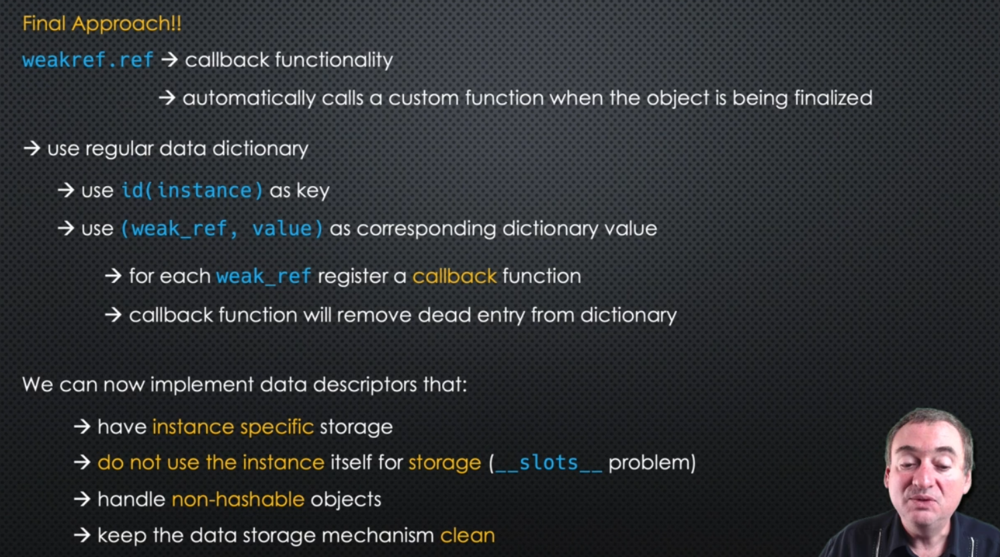

## Weakrefs are aware of when objects are destroyed!!!

In [112]:
p = Point2D(10,11)

calling set
self=<__main__.IntegerValue object at 0x000001EC9BEBF708>, instance=<__main__.Point2D object at 0x000001EC9BEA2AC8>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BEBF0C8>, instance=<__main__.Point2D object at 0x000001EC9BEA2AC8>


In [113]:
weak_p = weakref.ref(p)

In [114]:
weak_p

<weakref at 0x000001EC9BEE2EF8; to 'Point2D' at 0x000001EC9BEA2AC8>

In [115]:
ref_count(id(p))

1

In [116]:
del p

### Weakref was informed that the object was destroyed
### specify additional parameter for callback function

In [117]:
weak_p

<weakref at 0x000001EC9BEE2EF8; dead>

### HOOK into the garbage collection cycle!

In [121]:
def obj_destroyed(obj):
    '''
    it receives the weakref object, not the object that has being destroyed
    '''
    print(f'{obj} is being destroyed')

In [122]:
p = Point2D(10,11)
weak_p = weakref.ref(p, obj_destroyed)

calling set
self=<__main__.IntegerValue object at 0x000001EC9BEBF708>, instance=<__main__.Point2D object at 0x000001EC9BEF0148>
calling set
self=<__main__.IntegerValue object at 0x000001EC9BEBF0C8>, instance=<__main__.Point2D object at 0x000001EC9BEF0148>


In [123]:
del p

<weakref at 0x000001EC9BEF3B38; dead> is being destroyed


In [ ]:
import weakref

class IntegerValue:
    '''
    DESCRIPTOR
    ''' 
    def __init__(self):  # We are giving each attribute a separate name!
        #self.storage_name = '_' + name
        self.values = {}

    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        #setattr(instance, self.storage_name, int(value))
        
        self.values[id(instance)] = ( weakref.ref(instance, self._remove_object) , int(value) )    #here we assume instance is hashable!
        # get a weakref to instance
        # this assumes that the instnace is hashable and that you can have a weakref to it!
        
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        #previous
        #return getattr(instance, self.storage_name, None)
        value_tuple = self.values.get(id(instance))
        return value_tuple[1] # It returns None if we do get before set
        # self.values
    
    def _remove_object(self, weak_ref):
        print(f'removing dead entry for weakref={weak_ref}')
        
        for key, value in self.values.items():
            if value[0] is weak_ref:
                del self.values[key]
                break
                
        # or another way to do the same thing:
    

class Point2D:
    '''
    NO LONGER HASHABLE!!
    '''


    x = IntegerValue() 
    y = IntegerValue()
    
    def __init__(self, x, y):
        self.x = x
        self.y = y
        
    def __eq__(self, other):
        return isinstance(other, Point2D) and self.x ==other.x and self.y == other.y
    
    
class Person:
    __slots__ = 'name', '__weakref__'
    

### Each object has an attribute of `__weakref__`

In [ ]:
## If Person object uses slots then we canno

##  9th try (OK!) 

### Use instance dictionary to store the data (instead of data dictionary inside the descriptor)using `__set_name__` python>=3.6

 when we say `x = IntegerValue()` in the Point2D then if the IntegerValue descriptor implements the `__set_name__` function then the `x` is passed inside the set_name and we know what attribute this is for (think of it like x = IntegerValue('x') without having to say 'x')

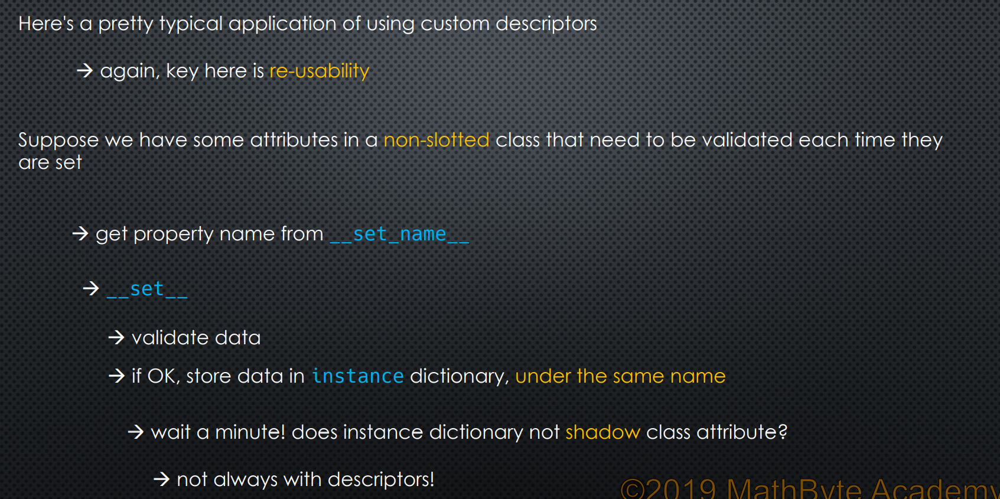

## This is the key difference between data and non-data descriptors (the shadowing!!)

`__set_name__`: recover the name of the property that the descriptor instance is being assigned to in our class

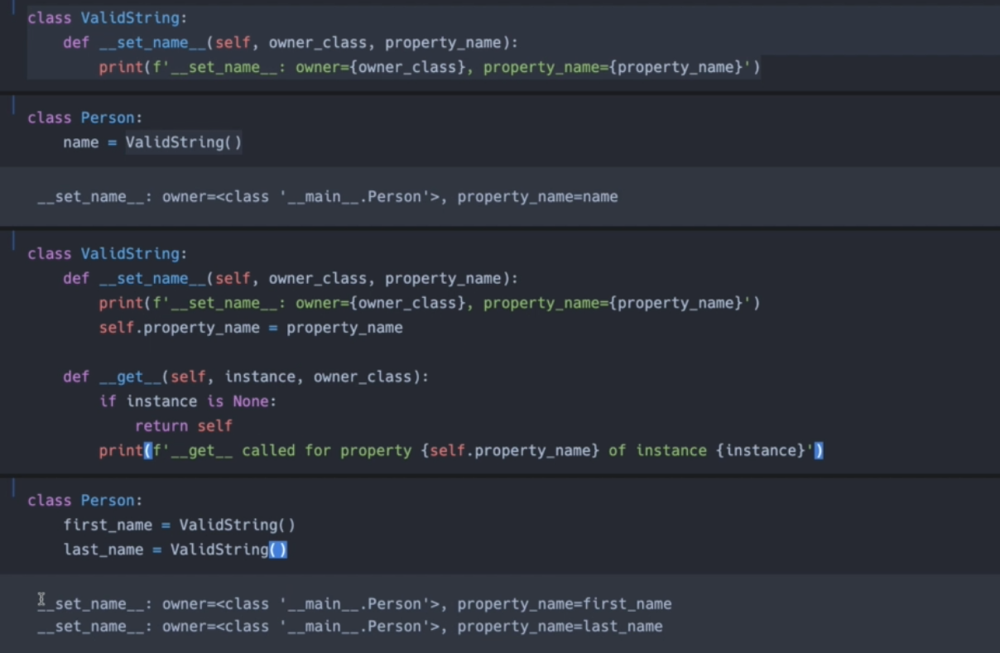

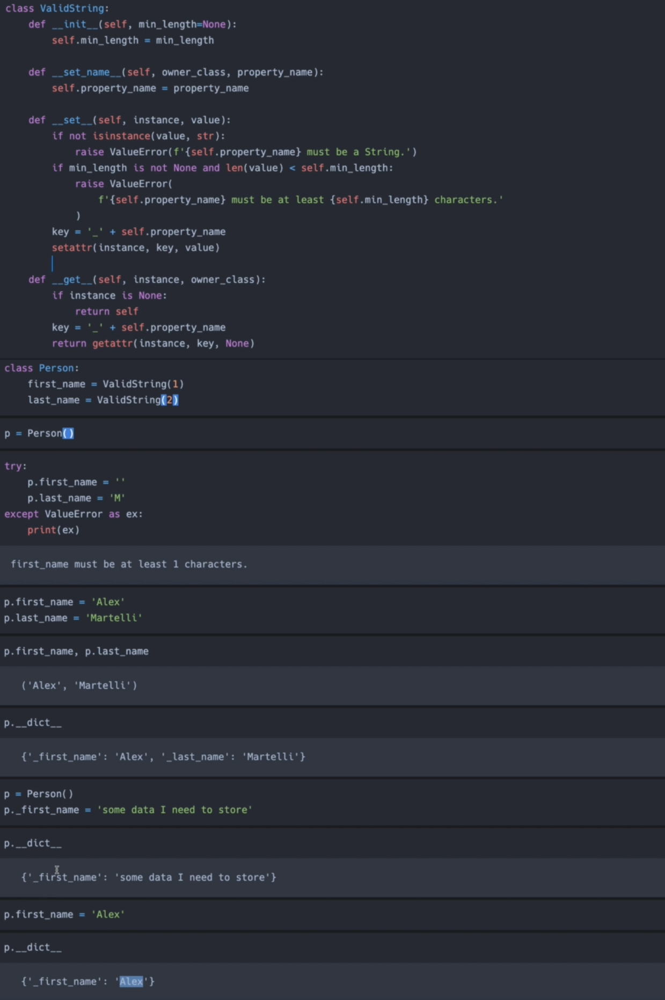

### Potential problems:
- if `_first_name` and `_last_name` are already defined by the user, they will be overriden!
-

### What happens if we use the self.property_name itself instead of key?
- e.g. use `first_name`. will it shadow the class attribute??
    - Answer: It depends if we are working with a data or non-data descriptor! 
    - If we use a DataDescriptor then the value is NOT shadowed!!!
    - In non-data descriptor the shadowing hapens!! The instance dictionary shadows the class attributes.

## Shadowing:

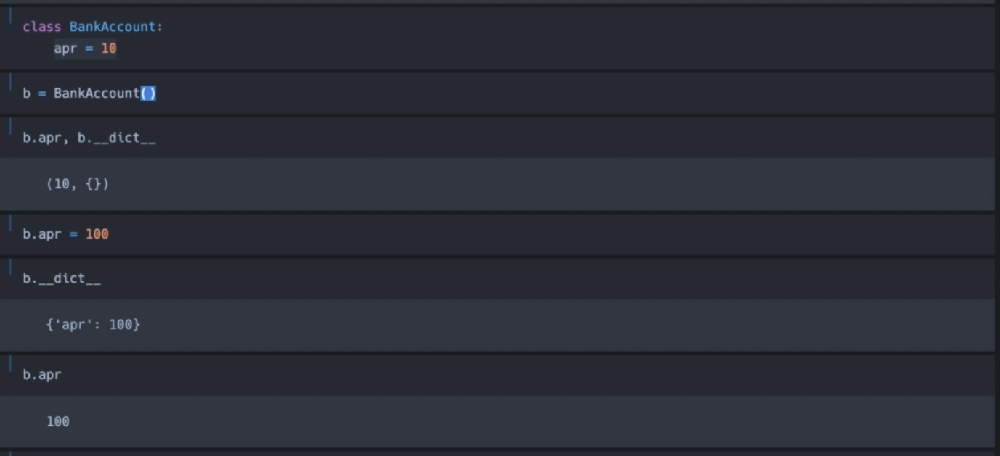

## Infinite recursion if you do it that way

This is because it is going to do: instance.property_name = value calling the set method again!

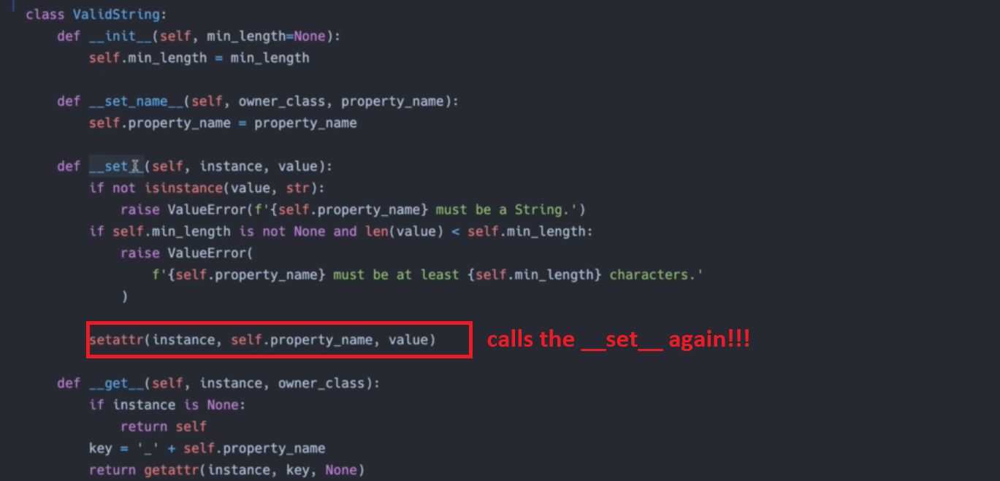

## Instead use the dictionary itself, bypassing the set and get!

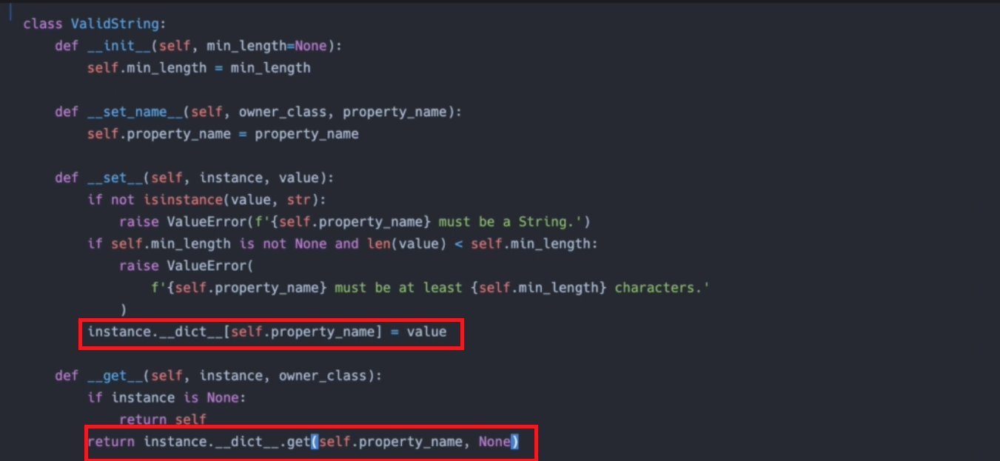

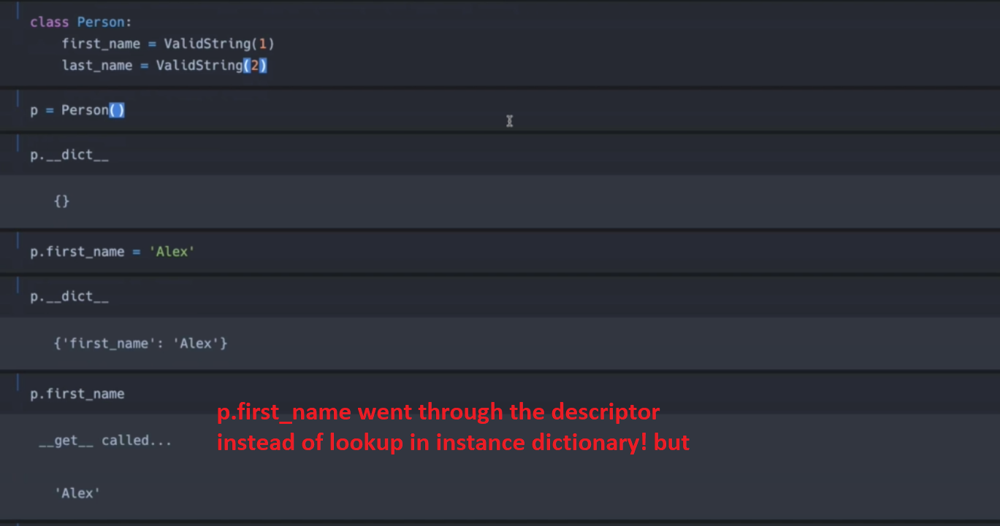

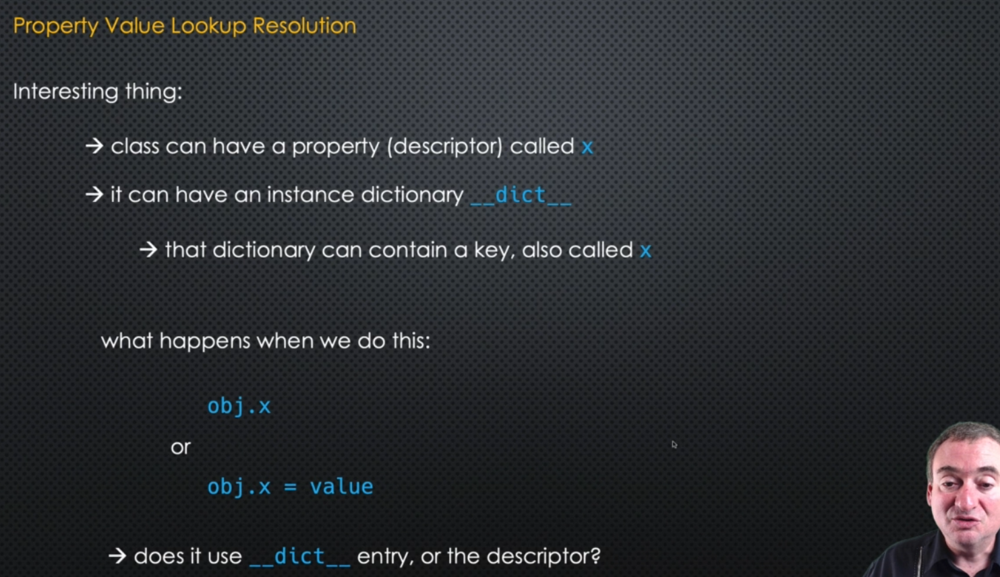

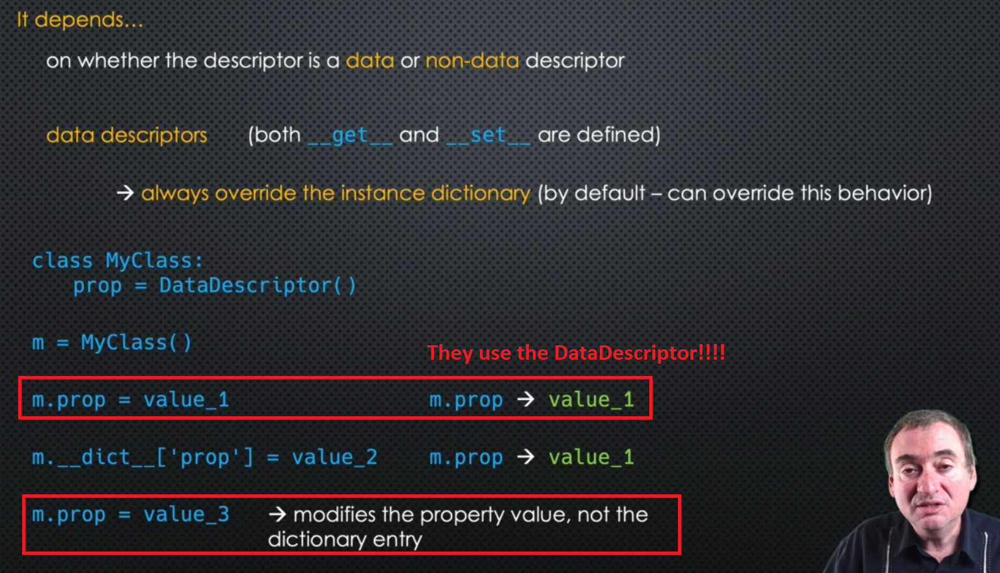

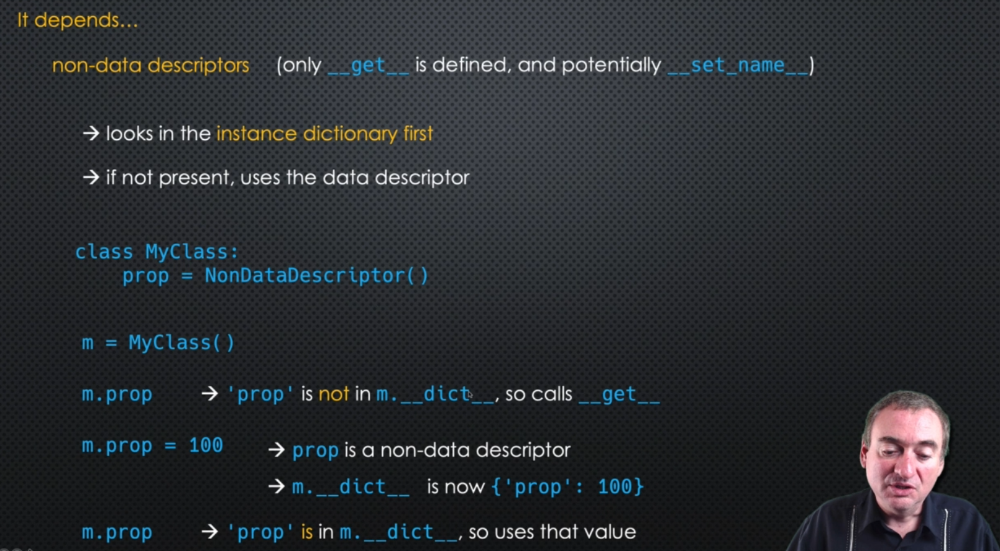

In [139]:
class ValidStr:
    def __init__(self, min_len):
        self.min_len = min_len
        
    def __set_name__(self, owner_cls, prop_name):#prop_name = property_name
        print('__set_name__ called')
        self.prop_name = prop_name
        
    def __set__(self, instance, value):
        print('__set__ called')
        instance.__dict__[self.prop_name] = value
        
    def __get__(self, instance, owner_cls):
        print('__get__ called')
        return instance.__dict__.get(self.prop_name, None)

In [140]:
class Person:
    firstname = ValidStr(1)
    lastname = ValidStr(2)

__set_name__ called
__set_name__ called


In [141]:
p = Person()

In [142]:
p.__dict__

{}

In [143]:
p.firstname = 'Theo'

__set__ called


In [144]:
p.__dict__

{'firstname': 'Theo'}

In [145]:
p.__dict__['firstname'] = 'Rallou'
p.__dict__

{'firstname': 'Rallou'}

In [146]:
p.firstname

__get__ called


'Rallou'

In [147]:
p2 = Person()
p2.__dict__['firstname'] = 'Georgia'

In [148]:
p2.firstname

__get__ called


'Georgia'

### The following assume that the class doesn't use slots, or if it uses it has __dict__ in the slots, because we use the instance dictionary 

In [127]:
class Time:
    def __get__(self, instance, owner_class):
        print('__get__ called...')
    
class Logger:
    cur_time = Time()

In [128]:
l = Logger()
l.cur_time

__get__ called...


In [129]:
l.cur_time = 1234

In [130]:
l.__dict__

{'cur_time': 1234}

In [131]:
l.cur_time

1234

In [132]:
class Time:
    def __get__(self, instance, owner_class):
        print('__get__ called...')
    
class Logger:
    cur_time = Time()

In [133]:
l = Logger()
l.cur_time

__get__ called...


In [135]:
l.__dict__['cur_time'] = 532234
l.__dict__

{'cur_time': 532234}

In [136]:
l.cur_time

532234

In [137]:
del l.__dict__['cur_time']
l.__dict__

{}

In [138]:
l.cur_time

__get__ called...


### Properties and Descriptors

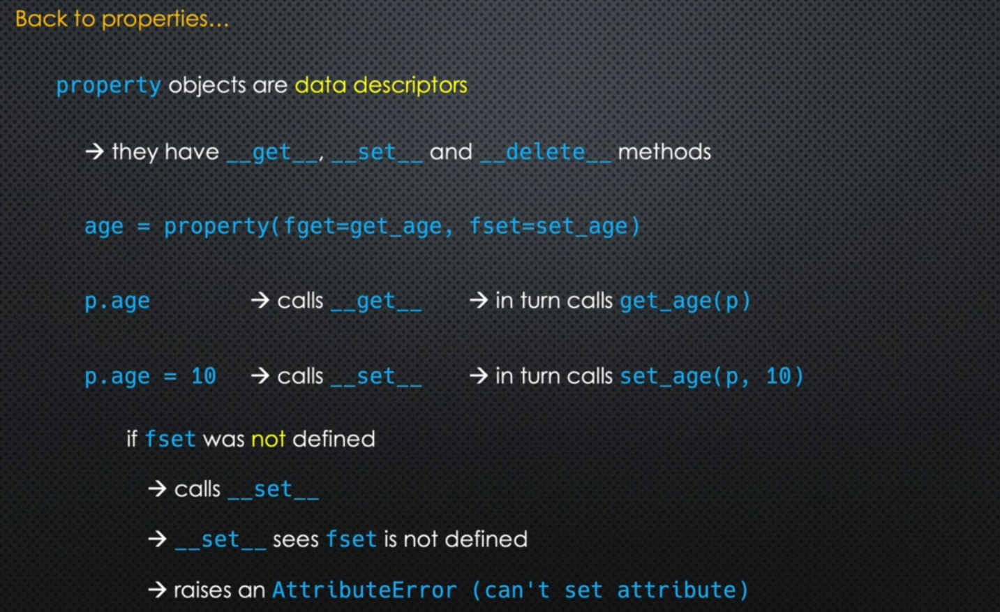

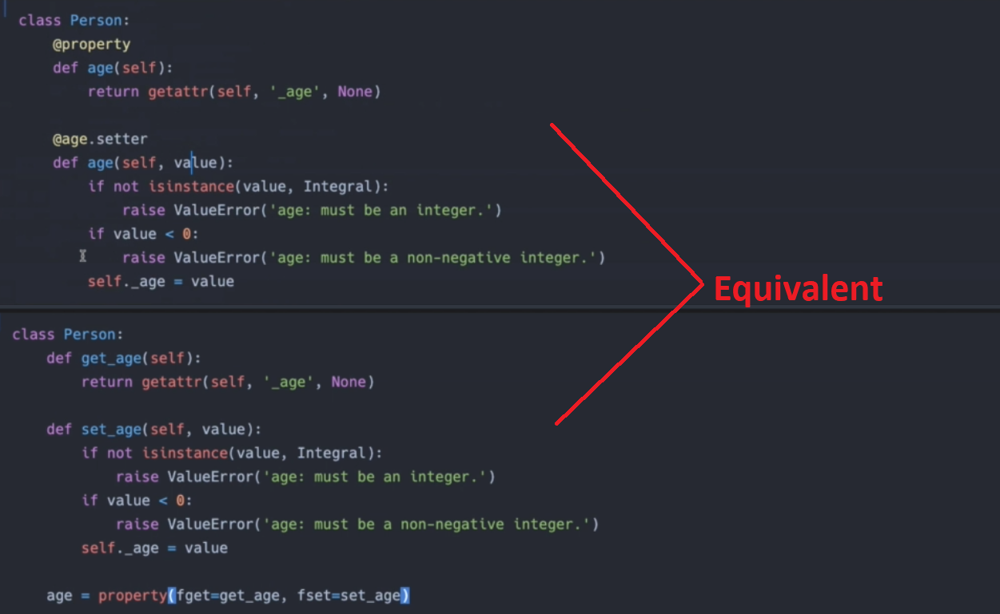

In [32]:
class Person:
    def get_age(self):
        return getattr(self, '_age', None)
    
    def set_age(self, value):
        self._age = value
        
    age = property(fget=get_age, fset=set_age)

In [33]:
prop = Person.age
prop

In [34]:
hasattr(prop, '__get__')

True

In [35]:
hasattr(prop, '__set__')

True

In [36]:
hasattr(prop, '__delete__')

True

`p.age` will call `__get__` which in turn will call `get_age`

No shadowing because property is a data descriptor

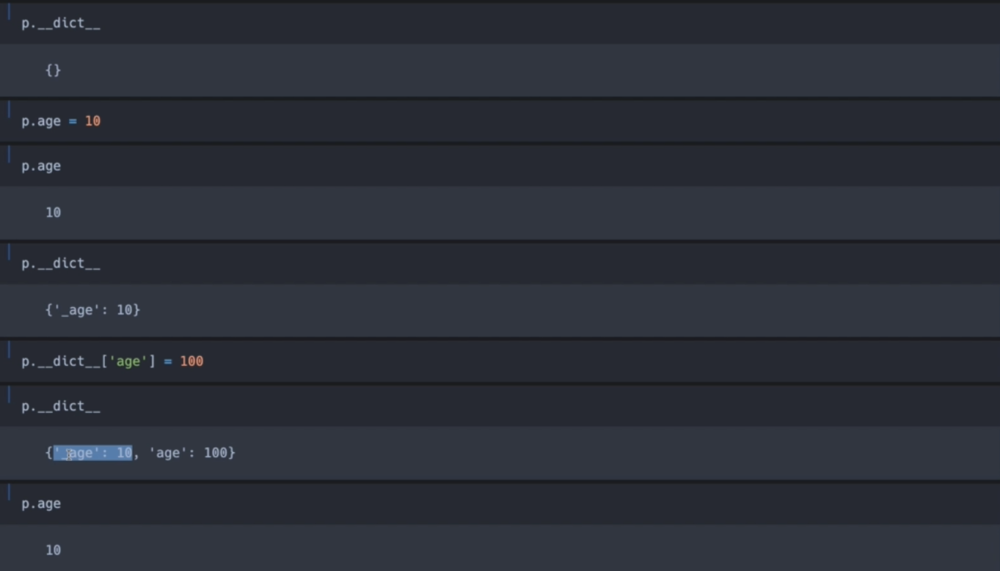

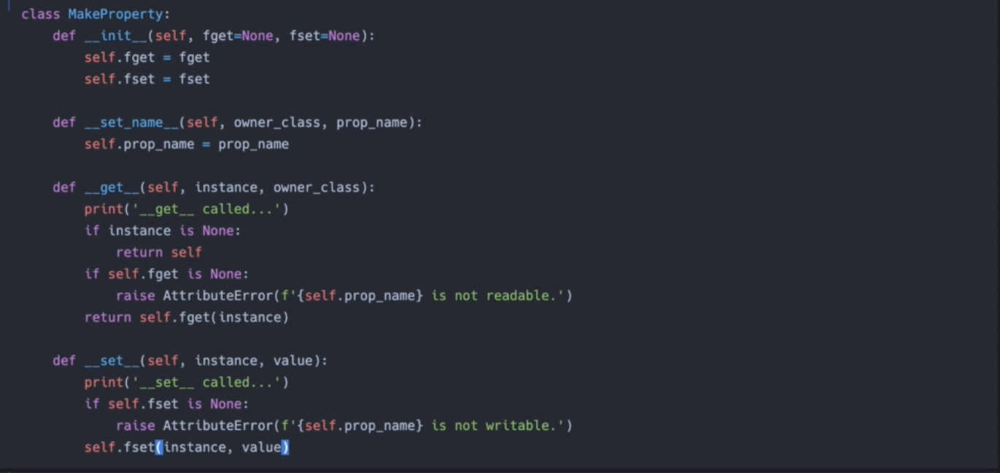

## IMPLEMENT PROPERTY AS DATA DESCRIPTOR FROM SCRATCH!

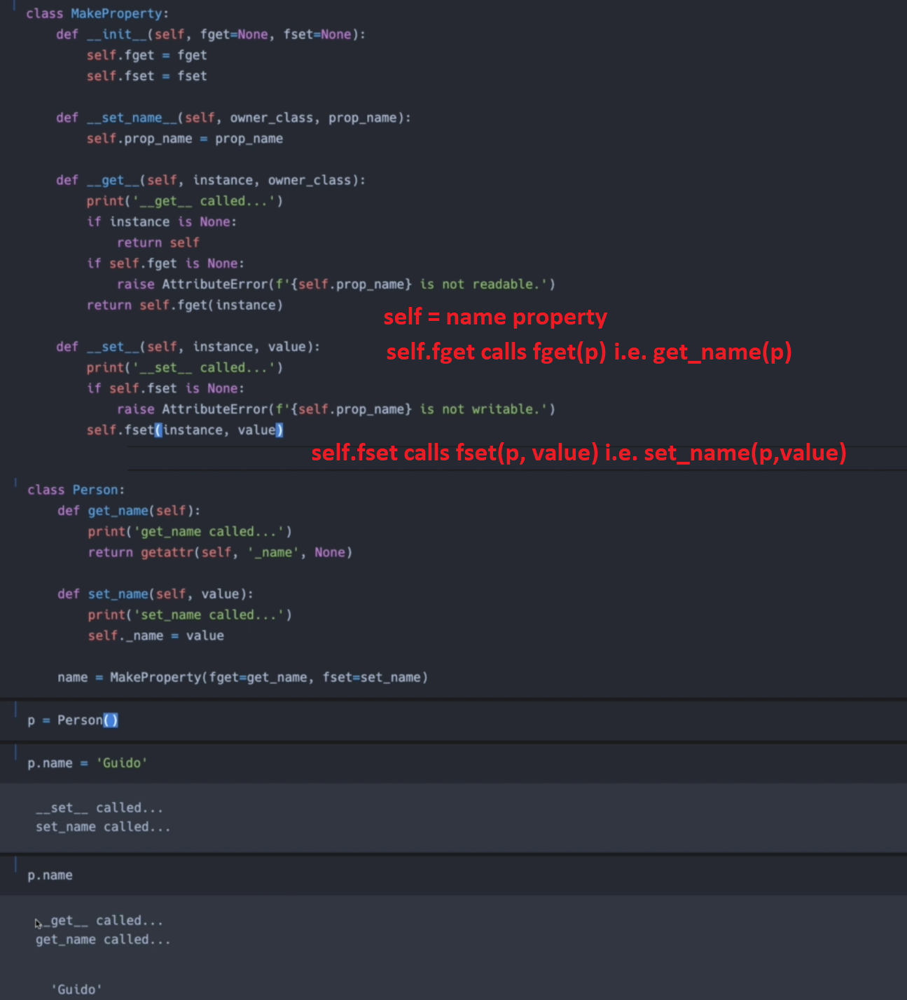

## NO SHADOWING!

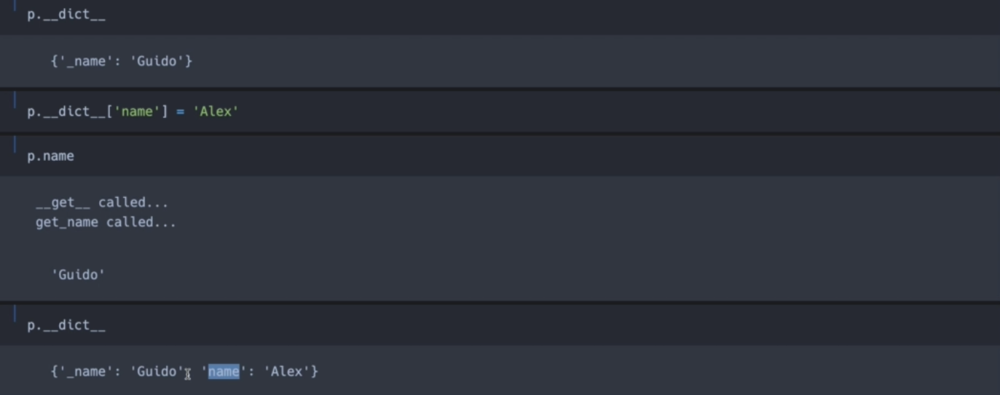

## using decorators

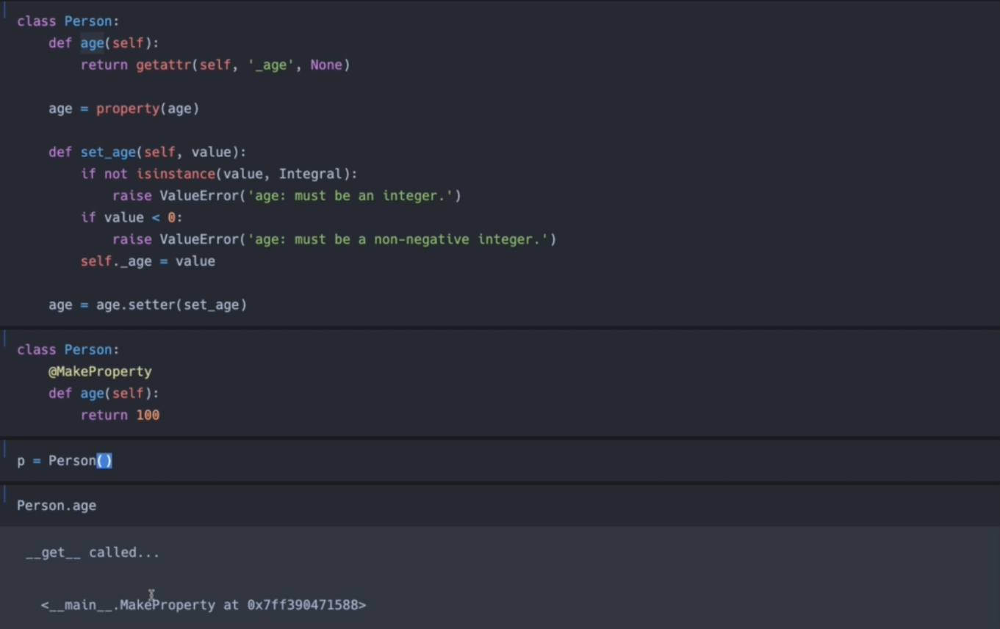

### MakeProperty `__init__` expects a function as arguments (possibly 2 functions fget and fset) and it returns an instance of the MakeProperty class. 

### So the `__init__` of the MakeProperty can be used as a decorator:
- input function
- outputs instance of MakeProperty

## EMULATE Property class

In [42]:
class MakeProperty:
    def __init__(self, fget=None, fset=None):
        self.fget = fget
        self.fset = fset
        
    def __set_name__(self, owner_class, prop_name):
        self.prop_name =prop_name
        
    def __get__(self, instance, owner_class):
        print('__get__ called from property')
        if instance is None:
            return self
        if self.fget is None:
            raise AttributeError(f'{self.prop_name} is not readable')
        return self.fget(instance)
    
    def __set__(self, instance, value):
        print('__set__ called from property')
        if self.fset is None:
            raise AttributeError(f'{self.prop_name} is not writable')
        return self.fset(instance, value)

In [45]:
class Person:
    
    def get_name(self):
        print('get_name called from Person class')
        return getattr(self, '_name', None)
    
    def set_name(self, value):
        print('set_name called from Person class')
        self._name = value
        #setattr(self, '_name', value)
        
    name = MakeProperty(fget=get_name, fset=set_name)

In [46]:
p = Person()
p.name

__get__ called from property
get_name called from Person class


In [47]:
p.name = 'Theo'

__set__ called from property
set_name called from Person class


In [48]:
p.name

__get__ called from property
get_name called from Person class


'Theo'

### How to emulate this?

In [52]:
class Person:
    @property
    def age(self):
        print('getter called')
        return getattr(self, '_age', None)
    
    @age.setter
    def age(self, value):
        print('setter called')
        self._age = value

In [53]:
p = Person()
p.age= 33

setter called


In [54]:
p.age

getter called


33

### Break it into parts

In [ ]:
class Person:
    
    def age(self):
        return getattr(self, '_age', None)
    
    age = property(age)
    
    def set_age(self, value):
        self._age = value
        
    age = age.setter(set_age)

In [ ]:
age = age.setter(set_func)

In [57]:
class MakeProperty:
    def __init__(self, fget=None, fset=None):
        self.fget = fget
        self.fset = fset
        
    def __set_name__(self, owner_class, prop_name):
        self.prop_name =prop_name
        
    def __get__(self, instance, owner_class):
        print('__get__ called from property')
        if instance is None:
            return self
        if self.fget is None:
            raise AttributeError(f'{self.prop_name} is not readable')
        return self.fget(instance)
    
    def __set__(self, instance, value):
        print('__set__ called from property')
        if self.fset is None:
            raise AttributeError(f'{self.prop_name} is not writable')
        return self.fset(instance, value)

    def setter(self, set_func):
        self.fset = set_func
        return self
        

In [58]:
class Person:
    
    @MakeProperty  #age = MakeProperty(age)  --> calls the __init__ of MakeProperty with argument age and reasigns it to variable age
    def age(self):
        print('getter called')
        return getattr(self, '_age', None)
    
    @age.setter
    def age(self, value):
        print('age.setter called')
        self._age = value

In [59]:
p = Person()
p.age = 22

__set__ called from property
age.setter called


In [60]:
p.age

__get__ called from property
getter called


22

========================
## Property Recap
========================

#### 1st Example

In [1]:
class Person:
    def __init__(self, name):
        #self._name = name  #maybe invalid entry. Do a validation
        #self.set_name(name)
        
        # it calls the setter in property which calls the set_name
        self.name = name 
        
    def get_name(self):
        print('getter called')
        return self._name
    
    def set_name(self, value):
        print('setter called')
        if isinstance(value, str) and len(value.strip()) >0:
            self._name = value.strip()
        else:
            raise ValueError('name must be non-empty string')
            
    name = property(fget=get_name, fset=set_name)

In [2]:
p = Person('Alex')

setter called


In [3]:
p.name

getter called


'Alex'

In [4]:
p.__dict__

{'_name': 'Alex'}

In [8]:
class Person:
    def __init__(self, language):
        self._language = language
        
    # This is the getter
    def language(self):
        print('getter called')
        return self._language
    
    # This acts as a decorator!
    language = property(fget=language)

In [9]:
p = Person('Greek')

In [10]:
p.language

getter called


'Greek'

In [11]:
p.__dict__

{'_language': 'Greek'}

### decorator syntax

In [19]:
class Person:
    def __init__(self, language):
        self._language = language
        
    # This is the getter
    @property
    def language(self):
        print('getter called')
        return self._language
    
    # now language is a property instance
    
    def set_language(self, value):
        print('setter called')
        self._language = value
        
    language = language.setter(set_language)

In [20]:
p = Person('Greek')

In [21]:
p.__dict__

{'_language': 'Greek'}

In [22]:
p.language

getter called


'Greek'

In [23]:
p.language = 'English'

setter called


In [24]:
p.language

getter called


'English'

In [25]:
class Person:
    def __init__(self, language):
        self.language = language
        
    # This is the getter
    @property
    def language(self):
        print('getter called')
        return self._language
    
    # now language is a property instance
    
    def set_language(self, value):
        print('setter called')
        self._language = value
        
    language = language.setter(set_language)

In [26]:
p = Person('Greek')

setter called


In [27]:
p.__dict__

{'_language': 'Greek'}

In [28]:
p.language

getter called


'Greek'

In [29]:
p.language = 'English'

setter called


In [30]:
p.language

getter called


'English'

## Decorator syntax for setter

In [31]:
def Person:
    def __init__(self, language):
        self._language = language
        
    # This is the getter
    @property
    def language(self):
        return self._language
    
    # now language is a property instance
    
    # language setter
    @language.setter
    def language(self, value):
        self._language = value


SyntaxError: invalid syntax (<ipython-input-31-4afa1a7a4d4d>, line 1)

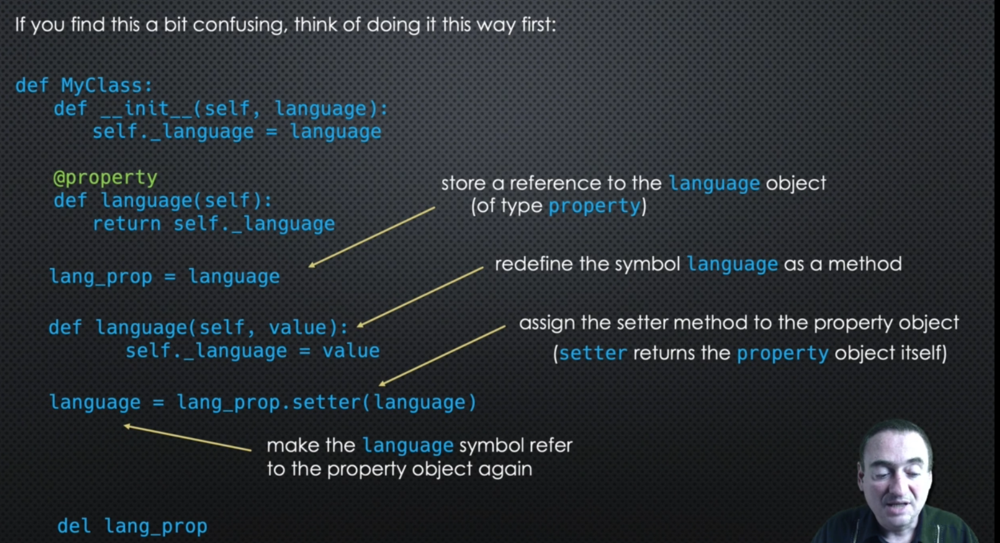

## Read-only property: only get method (not set)
## Computed Properties (Lazy Computation) and caching!

In [ ]:
import math 

class Circle:
    def __init__(self, r):
        self._r = r
        self._area = None
        
    @property
    def radius(self):
        return self._r
    
    @radius.setter
    def radius(self, r):
        if r<0:
            raise ValueError('Rabius should be non-negative')
        self._r = r
        self._area = None #Invalidate cahce when radius changes
        
    @property  #recalculcate area when changing radius r
    def area(self):
        if self._area is None:
            return math.pi * (self._r**2)
        return self._area

===========================
## Descriptors Recap
===========================
- Data Descriptors: Implement get-set or get-del or get-set-del.
- Non Data Descriptors: Implement only get.

## 1. Store on Descriptor dictionary
- It assumes that instance is `hashable`
- It assumes that we can have weakref to instnace

In [ ]:
import weakref

class IntegerValue:
    '''
    Data Descriptor
    '''
    
    def __init__(self,value):
        # Problem with that are memory leaks! 
        # It stores strong ref to object as keys!
        #self.data  = {}
        
        # This is better since keys now are weakrefs to objects!
        # No memory leaks!
        self.data = weakref.WeakKeyDictionary()
        
    def __get__(self, instance, owner_class):
        '''
        self = instace of descriptor
        instance = either instance of Point or None if class from class Point
        owner_class = Point
        '''
        # what if instance is not in dictionary? e.g. if get is called b4 set
        #return self.data[instance]
        if instance is None:
            return self
        return self.data.get(instance, None)
    
    def __set__(self, instance, value):
        #assumes that instance is HASHABLE
        self.data[instance] = value
    
    

In [ ]:
class Point2D:
    x = IntegerValue()
    y = IntegerValue()

## 2. Takle the hashability + slots weakref issue

- **Use id(instance) as a key:** works for non HASHABLE objects since we store the ID and not the instance itself
- still not storing strong ref to dictionary as in 6th
- **Use (weak_ref, value) as dictionary value:** If the object is finalized and garbage collected, the corresponding entry still remains in the dictionary. The data dictioanry may contain id of instances that no longer exist and there is also a chance that the id itself is re-used.
- **If Person object uses slots then we cannot create weakrefs** to person instances, because the `__weakref__` and `__dict__` will be overriden with slots. solution: `__slots__ = 'name', '__weakref__'`


In [ ]:
import weakref

class IntegerValue:
    '''
    DESCRIPTOR
    ''' 
    def __init__(self):  # We are giving each attribute a separate name!
        #self.storage_name = '_' + name
        self.values = {}

    def __set__(self, instance, value):
        print('calling set')
        print(f'self={self}, instance={instance}')

        #setattr(instance, self.storage_name, int(value))
        
        self.values[id(instance)] = ( weakref.ref(instance, self._remove_object) , int(value) )    #here we assume instance is hashable!
        # get a weakref to instance
        # this assumes that the instnace is hashable and that you can have a weakref to it!
        
            
    def __get__(self, instance, owner_class):
        '''
        self: is instance of IntegerValue
        instance: is either point instance or None if called from class
        owner_class: is Point2D is both cases
        '''
        print('calling get')
        print(f'self={self}, instance={instance}, owner_class={owner_class}')
        if instance is None:
            return self
        #previous
        #return getattr(instance, self.storage_name, None)
        value_tuple = self.values.get(id(instance))
        return value_tuple[1] # It returns None if we do get before set
        # self.values
    
    def _remove_object(self, weak_ref):
        print(f'removing dead entry for weakref={weak_ref}')
        
        for key, value in self.values.items():
            if value[0] is weak_ref:
                del self.values[key]
                break
                
        # or another way to do the same thing:
    

class Point2D:
    '''
    NO LONGER HASHABLE!!
    '''


    x = IntegerValue() 
    y = IntegerValue()
    
    def __init__(self, x, y):
        self.x = x
        self.y = y
        
    def __eq__(self, other):
        return isinstance(other, Point2D) and self.x ==other.x and self.y == other.y
    
    
class Person:
    __slots__ = 'name', '__weakref__'
    

## 3. Store on instance using `__set_name__`

In [ ]:
class ValidStr:
    def __init__(self, min_len):
        self.min_len = min_len
        
    def __set_name__(self, owner_cls, prop_name):#prop_name = property_name
        print('__set_name__ called')
        self.prop_name = prop_name
        
    def __set__(self, instance, value):
        print('__set__ called')
        instance.__dict__[self.prop_name] = value
        
    def __get__(self, instance, owner_cls):
        print('__get__ called')
        return instance.__dict__.get(self.prop_name, None)

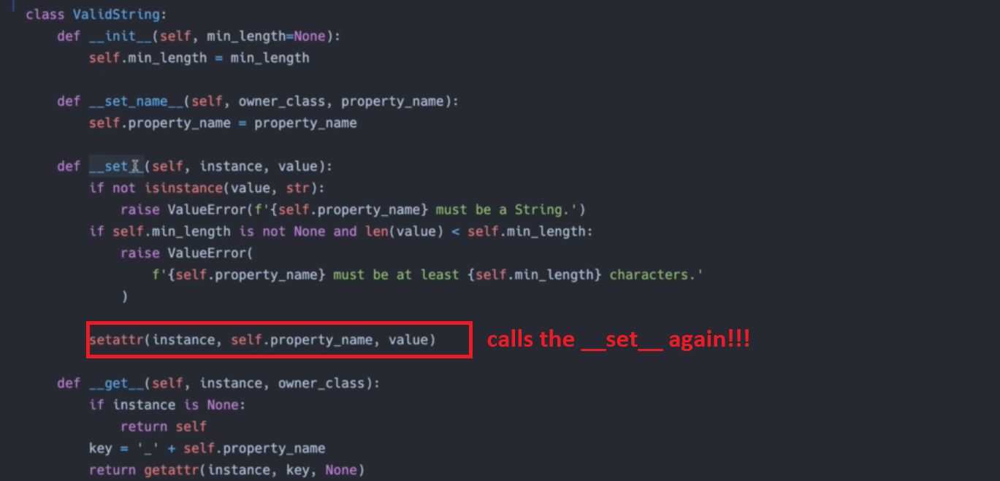

In [12]:
class IntegerValue:
    '''
    Data Descriptor
    '''
        
    def __set_name__(self, owner_class, name):
        print('__set_name__ called')
        self.property_name = name
        
    def __init__(self, min_len):
        #instance.self.property_name  = value
        self.min_len = min_len
    
    def __get__(self, instance, owner_class):
        '''
        self = instace of descriptor
        instance = either instance of Point or None if class from class Point
        owner_class = Point
        '''
        print('getter called')
        #self.values.get(id(instance)) 
        
        # this will result into INFINITE RECURSION!!!
        # because it calls __get__ again!
        #getattr(instance, self.property_name, None )
        
        # Instead, modify the dictionary it self!
        if instance is None:
            return self
        return instance.__dict__.get(self.property_name, None)
    
    def __set__(self, instance, value):
        print('setter called')
        #self.data[id(instance)] = value
        
        # this will result into INFINITE RECURSION!!!
        # because it calls __set__ again!
        #setattr(instance, self.property_name, value)
        
        # Instead, modify the dictionary it self!
        if len(value) < self.min_len:
            raise ValueError(f'{self.property_name} should be at least {self.min_len} characters')
        instance.__dict__[self.property_name] = value

In [13]:
class Person:
    firstname = IntegerValue(1)
    lastname = IntegerValue(2)

__set_name__ called
__set_name__ called


In [14]:
p = Person()

In [15]:
p.__dict__

{}

In [16]:
p.firstname

getter called


In [17]:
p.firstname = "Theo"
p.lastname = "Kasioumis"

setter called
setter called


In [18]:
p.__dict__

{'firstname': 'Theo', 'lastname': 'Kasioumis'}

In [19]:
p.firstname

getter called


'Theo'

## My attempt: Try to define property from scratch using data descriptors

In [169]:
class Property:
    
    def __init__(self, fget=None, fset=None, fdel=None):
        print('Property init')
        self.getter = fget
        self.setter = fset
        self.deleter = fdel
    
    def __set_name__(self, owner_cls, prop_name):#prop_name = property_name
        print('__set_name__ called')
        self.prop_name = prop_name
        
#     def __set__(self, instance, value):
#         print('__set__ called')
#         instance.__dict__[self.prop_name] = value
        
    def __get__(self, instance, owner_cls):
        print('__get__ called')
        #return instance.__dict__.get(self.prop_name, None)
        return self.getter(instance)
    

In [170]:
from math import pi

In [177]:
class Circle:
    
    def __init__(self, radius):
        self._radius = radius
        #self.area = None
             
    def get_area(self):
        print('Computing area on-the-fly')
        return pi * self.radius ** 2
    
    area = Property(fget = get_area)
    

Property init
__set_name__ called


In [178]:
c= Circle(4)

In [179]:
c.__dict__

{'_radius': 4}

In [181]:
print(c.area)

__get__ called
Computing area on-the-fly


AttributeError: 'Circle' object has no attribute 'radius'

In [176]:
c.area

In [175]:
Circle.area

__get__ called
Computing area on-the-fly


AttributeError: 'NoneType' object has no attribute 'radius'

## Applications
1. DATA VALIDATION!
2. RE-USABILITY

see DESCRIPTORS.ipynb

# 1.

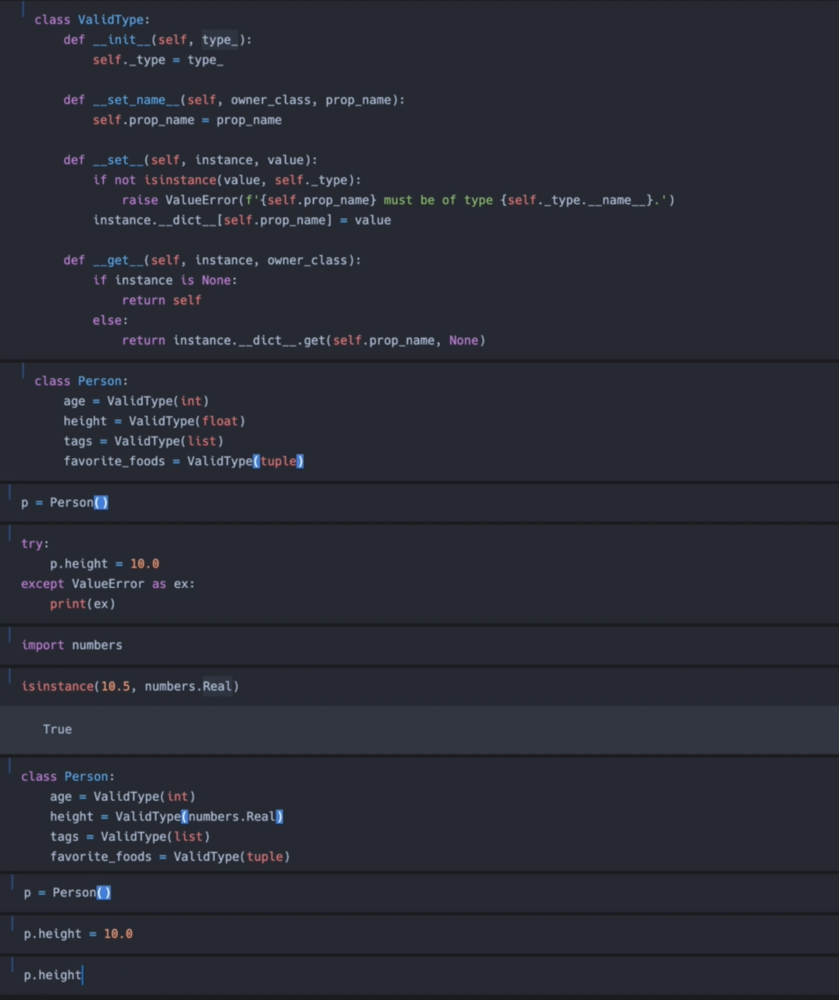

# 2.

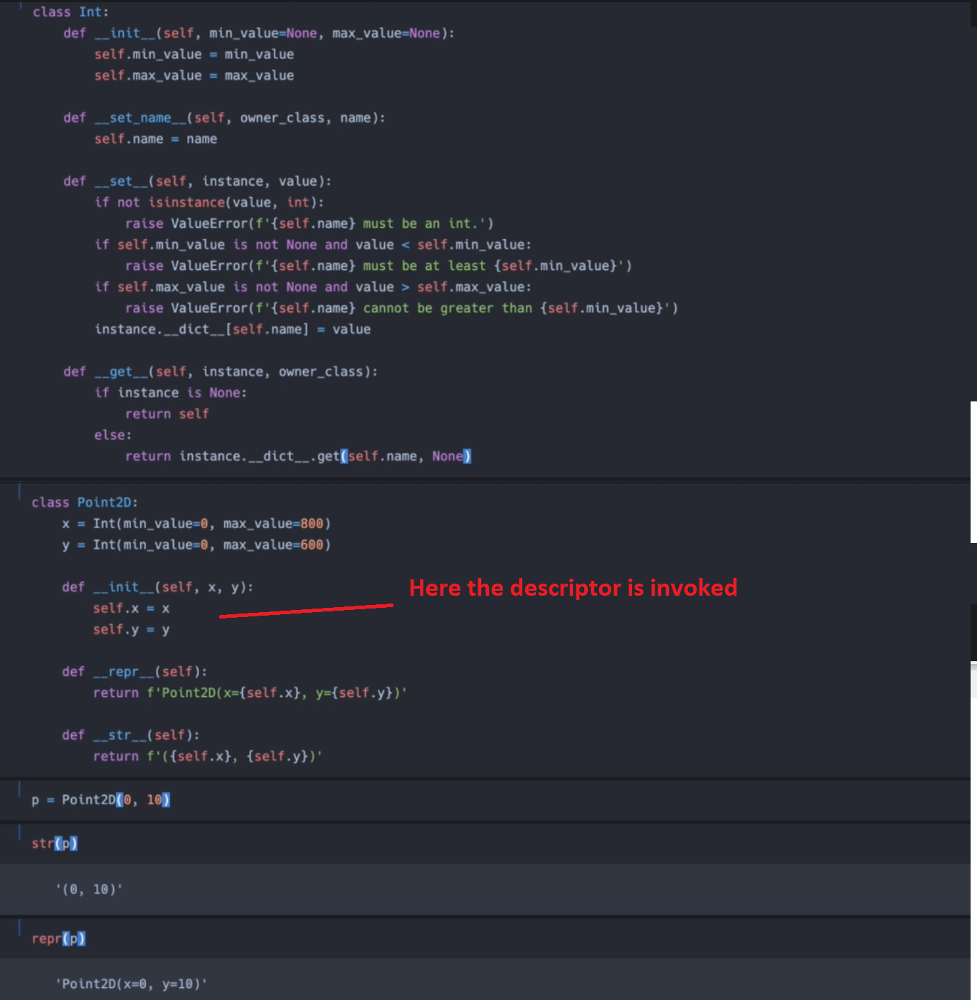

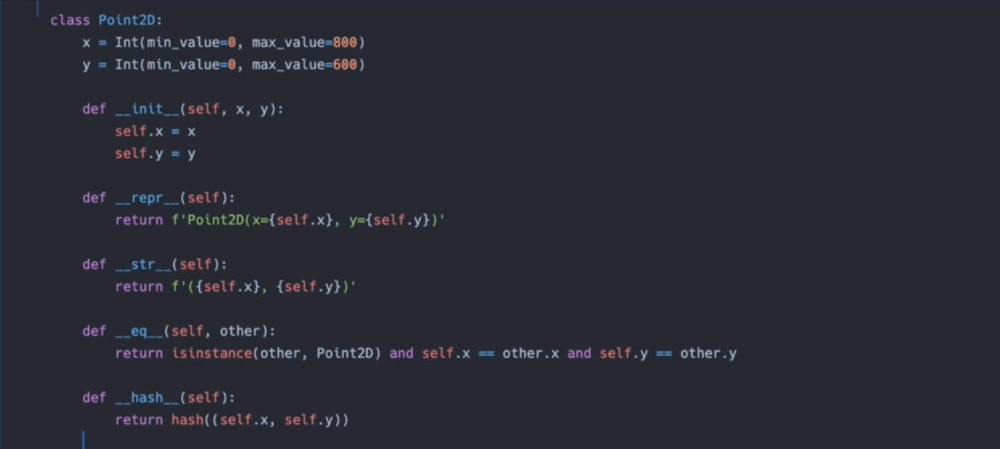

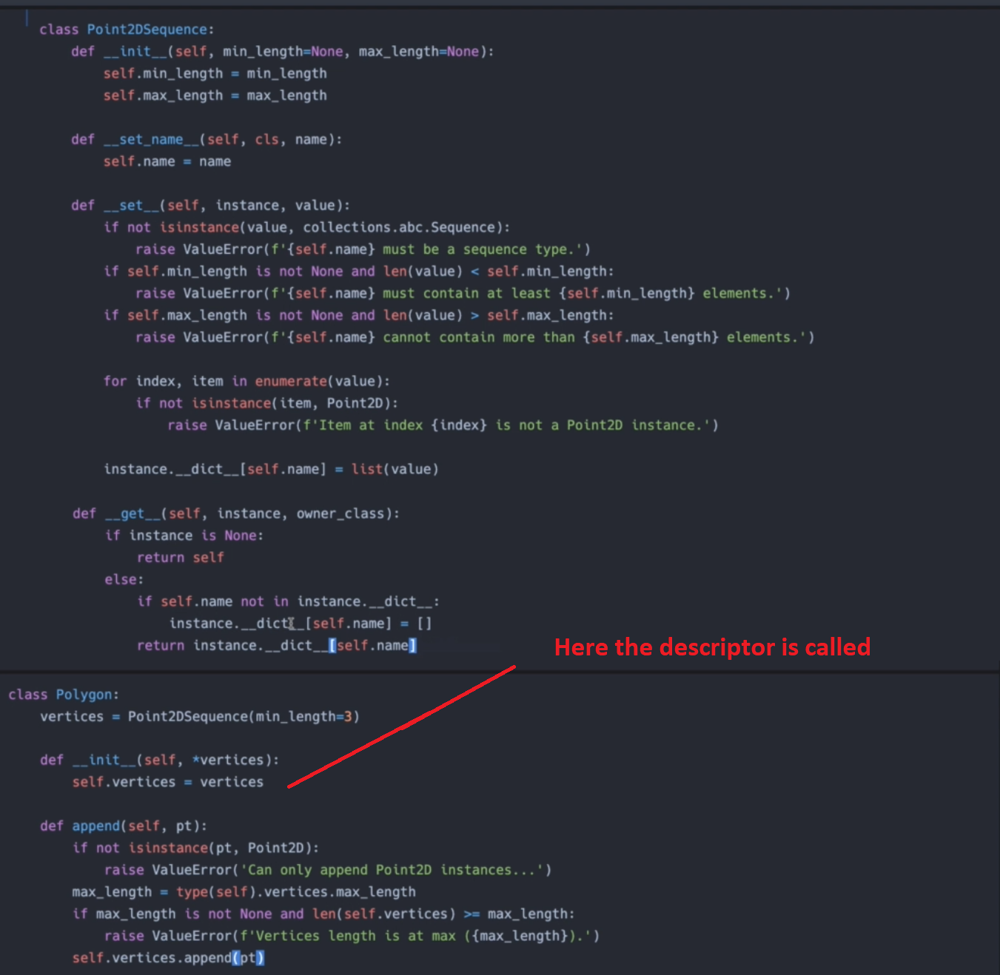

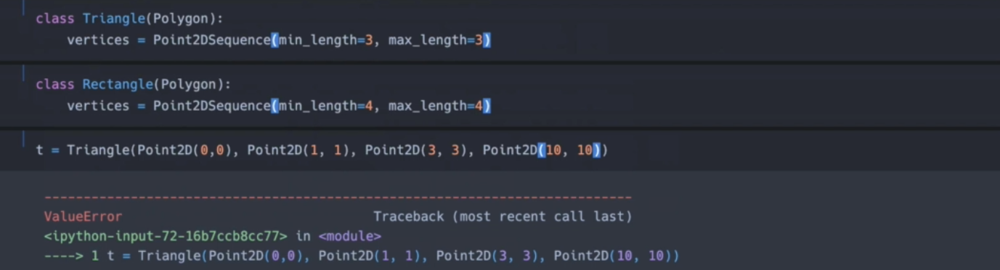

### We could make Polygon a sequence type itself! 

Need to implement the following methods:
- `__len__`
- `__getitem__`  (the second argument could be integer or slice) 
- 

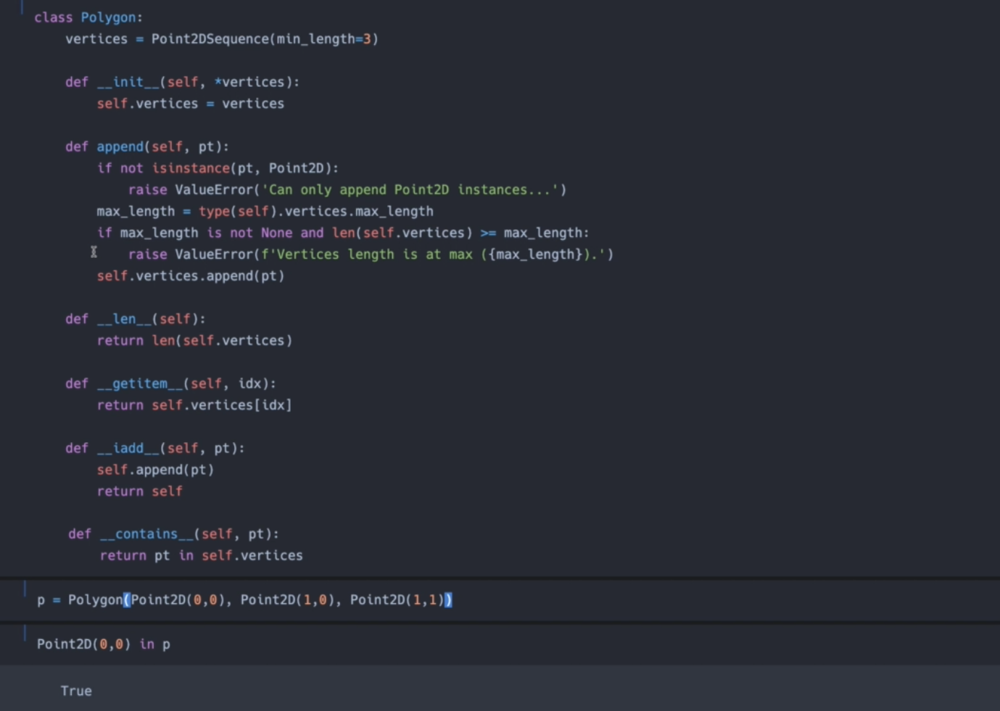

## Functions and descriptors

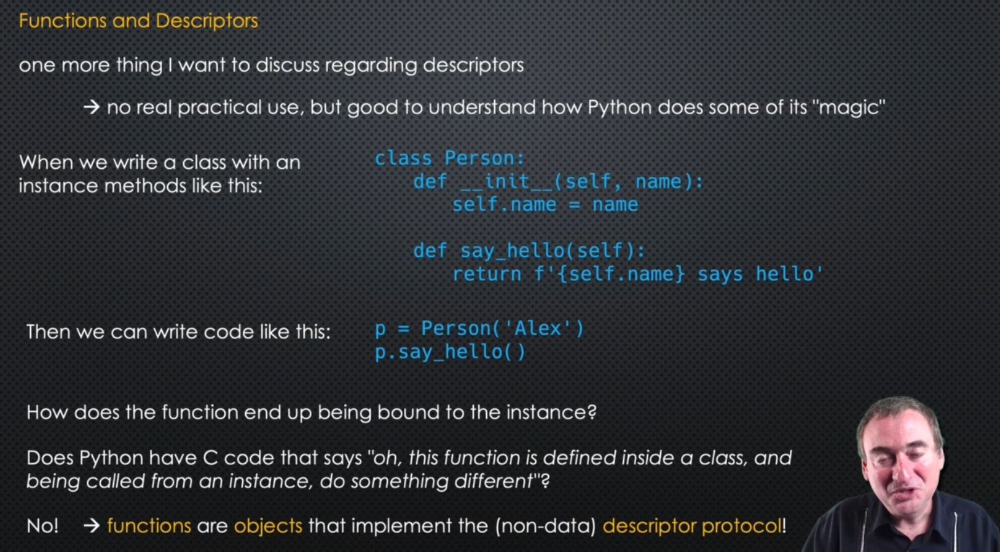

### when calling `__get__` from a function, either will return the function or the bound method

### Functions use the descriptor protocol in order to provide us bound methods when we define them in classes

### Functions are non-data descriptors

In [61]:
def add (a,b):
    return a + b

In [62]:
hasattr(add, '__get__') # functions have a __get__ method

True

In [63]:
hasattr(add, '__set__')

False

### What does the `__get__` actually return??

the arguments of `__get__` are
- self= instance of the descriptor, i.e. the fucntion add
- instance =  None when called from the class (i.e. module that contains our function)
- owner_class = main module

- if we call `__get__` from class we return self (i.e. the descriptor/function)
- if we call `__get__` from instance we return a bound method

In [65]:
import sys
me = sys.modules['__main__']
me

<module '__main__'>

In [67]:
# we need instance and owner_class. self = add, since it is going to be passed in as bound method
f = add.__get__(None, me)
f

<function __main__.add(a, b)>

In [68]:
f  is add

True

## My work:

In [79]:
class MyDescriptor():
#     def __init__(self, instance):
#         self.f = lambda : f'{instance.name} says hello!'
    
    def __set_name__(self, owner_cls, prop_name):#prop_name = property_name
        print('__set_name__ called')
        self.prop_name = prop_name
        
    def __get__(self, instance, owner_cls):
        print('__get__ called')
        if instance is None:
            return self
        return lambda : f'{instance.name} says hello!'
        

class Person:
    # typically this is a data descriptor also!
    def __init__(self,name):
        self.name = name
    
    # data descriptor
    say_hello = MyDescriptor()

__set_name__ called


In [80]:
p = Person('Theo')

In [81]:
p.name

'Theo'

In [82]:
p.say_hello

__get__ called


<function __main__.MyDescriptor.__get__.<locals>.<lambda>()>

In [83]:
p.say_hello()

__get__ called


'Theo says hello!'

In [84]:
Person.say_hello

__get__ called


In [85]:
Person.say_hello.__get__

__get__ called


<bound method MyDescriptor.__get__ of <__main__.MyDescriptor object at 0x0000024AB810DD88>>

In [86]:
Person.say_hello.__get__(p, Person)

__get__ called
__get__ called


<function __main__.MyDescriptor.__get__.<locals>.<lambda>()>

In [87]:
class Person:
    def __init__(self, name):
        self.name = name
    
    def say_hello(self):
        return f'{self.name} says hello!'

In [88]:
Person.say_hello

<function __main__.Person.say_hello(self)>

In [89]:
p =  Person('Alex')
p.say_hello

<bound method Person.say_hello of <__main__.Person object at 0x0000024AB8140908>>

In [91]:
bound_method = Person.say_hello.__get__(p, Person)
bound_method

<bound method Person.say_hello of <__main__.Person object at 0x0000024AB8140908>>

#### the `__get__` method return a NEW object everytime we access say.hello from instnace

In [93]:
f1 = p.say_hello 
f2 = p.say_hello

f1, f2

(<bound method Person.say_hello of <__main__.Person object at 0x0000024AB8140908>>,
 <bound method Person.say_hello of <__main__.Person object at 0x0000024AB8140908>>)

In [94]:
f1 is f2

False

#### when we says p.say_hello python is calling the `__get__` method of the function and return a bound method

In [95]:
bound_method.__func__

<function __main__.Person.say_hello(self)>

In [96]:
p.say_hello.__func__

<function __main__.Person.say_hello(self)>

In [ ]:
class Person:
    def __init__(self, name):
        self.name = name
        
    def say_hello(self):
        return f'{self.name} says hello'

#### Write descriptor to replace `def say_hello`
- if we call it from Person class it should return the function (descriptor) itself
- if we call it from instance of Person class, it should reutrn a bound method object

In [97]:
#define it in the module level
def say_hello(self):
    return f'{self.name} says hello'  #self should have .name attribute

#### we want the descriptors `__get__`  to return a bound method (function bound to instance)

In [98]:
say_hello

<function __main__.say_hello(self)>

In [99]:
import types

In [100]:
help(types.MethodType)

Help on class method in module builtins:

class method(object)
 |  method(function, instance)
 |  
 |  Create a bound instance method object.
 |  
 |  Methods defined here:
 |  
 |  __call__(self, /, *args, **kwargs)
 |      Call self as a function.
 |  
 |  __delattr__(self, name, /)
 |      Implement delattr(self, name).
 |  
 |  __eq__(self, value, /)
 |      Return self==value.
 |  
 |  __ge__(self, value, /)
 |      Return self>=value.
 |  
 |  __get__(self, instance, owner, /)
 |      Return an attribute of instance, which is of type owner.
 |  
 |  __getattribute__(self, name, /)
 |      Return getattr(self, name).
 |  
 |  __gt__(self, value, /)
 |      Return self>value.
 |  
 |  __hash__(self, /)
 |      Return hash(self).
 |  
 |  __le__(self, value, /)
 |      Return self<=value.
 |  
 |  __lt__(self, value, /)
 |      Return self<value.
 |  
 |  __ne__(self, value, /)
 |      Return self!=value.
 |  
 |  __reduce__(...)
 |      Helper for pickle.
 |  
 |  __repr__(self, /)

In [101]:
class Person:
    def __init__(self, name):
        self.name = name

In [102]:
p = Person('Theo')

In [104]:
m = types.MethodType(say_hello, p)
p

In [106]:
m  # bound method to person object. It is a method object

<bound method say_hello of <__main__.Person object at 0x0000024AB812EA08>>

In [107]:
p

In [108]:
m.__func__

<function __main__.say_hello(self)>

In [109]:
m()

'Theo says hello'

#### We want descriptor that when it is called we return `__main__.say_hello` and when it is called from instance we return the bound method from types.MethodType

In [110]:
class MyFunc:
    '''
    THIS IS THE DESCRIPTOR!!!!!
    '''
    def __init__(self, func):
        self._func  = func
        
        
    def __get__(self, instance, owner_class):
        if instance is None:
            print('__get__ called from class')
            return self._func
        
        else:
            print('__get__ called from instance')
            return types.MethodType(self._func, instance) # bound method to instnace

In [111]:
def hello_func(self):
    print(f'{self.name} says hello!')

In [112]:
class Person:
    def __init__(self, name):
        self.name = name
        
    # say_hello is a class attribute that is an instance of my descriptor    
    say_hello = MyFunc(hello_func)

In [113]:
p = Person('Theo')

In [114]:
p.say_hello

__get__ called from instance


<bound method hello_func of <__main__.Person object at 0x0000024AB81032C8>>

In [116]:
p.say_hello.__func__

__get__ called from instance


<function __main__.hello_func(self)>

In [115]:
Person.say_hello

__get__ called from class


<function __main__.hello_func(self)>

In [117]:
f1 = p.say_hello.__func__
id(f1)

__get__ called from instance


2519939061656

In [118]:
f2 = Person.say_hello
id(f2)

__get__ called from class


2519939061656

In [119]:
f1 is f2

True

In [120]:
f3 = p.say_hello
id(f3)

__get__ called from instance


2519937956104